<a href="https://colab.research.google.com/github/vanessavmac/syde572-intro-to-pattern-recognition/blob/main/syde572_style_transfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SYDE572 Assignment 5 - Style Transfer

[Abstract style image](https://www.tensorflow.org/tutorials/generative/style_transfer)

[Gram Matrix style transfer method](https://www.tensorflow.org/tutorials/generative/style_transfer)

[Sliced Wasserstein Distance style transfer method](https://github.com/tchambon/A-Sliced-Wasserstein-Loss-for-Neural-Texture-Synthesis?tab=readme-ov-file)


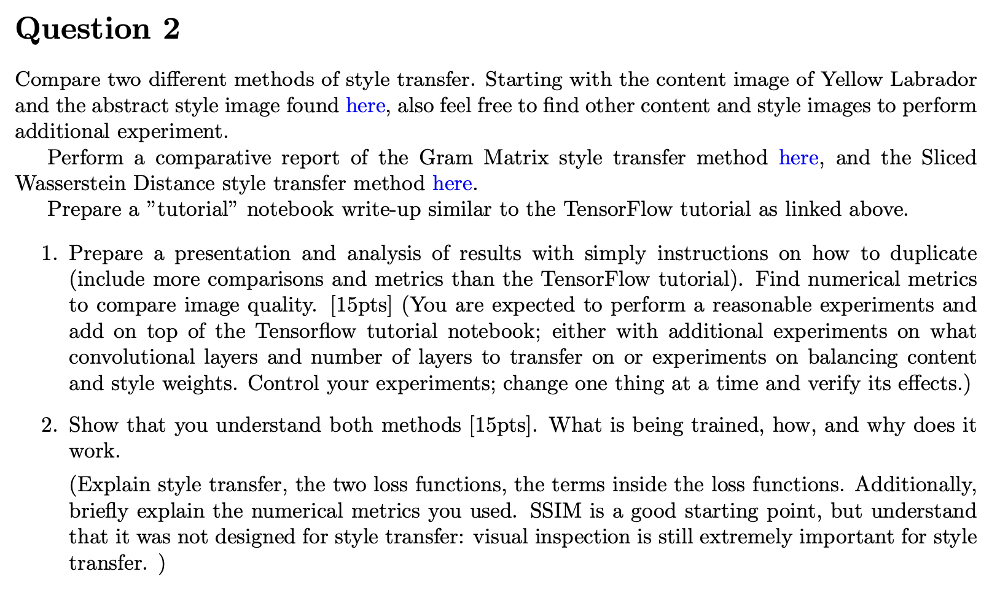

# Question 2

In [ ]:
import os
import tensorflow as tf
# Load compressed models from tensorflow_hub
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'

import IPython.display as display

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12, 12)
mpl.rcParams['axes.grid'] = False

import numpy as np
import PIL.Image
import time
import functools
import torch
import time
import datetime
import cv2

from skimage.metrics import structural_similarity as ssim
from scipy.stats import wasserstein_distance

tf.test.gpu_device_name()


'/device:GPU:0'

## What is style transfer?

Style transfer optimizes over a content image given another style reference image. Using optimization techniques like gradient descent, the style loss (difference in style features between the output and style image) and content loss (difference in content features between the output and original content image) are minimized. The final goal is an output image which looks like the content image but in the artistic style of the style image. To achieve this, style/content statistics must be extracted as features from the content/style image. One method of doing this is using a CNN (i.e. VGG19).

Detailed descriptions of the methods used are documented throughout the notebook.

## Set Up: Base Model/Helper Functions

Define helper functions to load/visualize data.

In [ ]:
# Display image using PIL
def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)

# Load, resize image, and limit its maximum dimension to 512 pixels
def load_img(path_to_img):
  max_dim = 256
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)
  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  small_dim = tf.cast(min(shape), tf.int32)
  img = tf.image.resize_with_crop_or_pad(img, small_dim, small_dim)
  img = tf.image.resize(img, [max_dim, max_dim])
  img = img[tf.newaxis, :]
  return img

# Display image using matplotlib
def imshow(image, title=None):
  if len(image.shape) > 3:
    image = tf.squeeze(image, axis=0)
  plt.imshow(image)
  if title:
    plt.title(title)

# Clip gradients during gradient descent
def clip_0_1(image):
  # Images are of type float; for stable GD and to prevent exploding gradients, pixel values are bounded between 0 and 1:
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)


To control experiments, utlize the same base ImageNet pretrained VGG19 TF model.

A VGG model is built to extract the outputs from the intermediate layers of the pretrained ImageNet VGG19. The activation outputs/feature maps of each layer of the VGG use convolution filters to identify style/content features/representations extracted from the style/content images. The benefit of CNNs are that convolutions can extract features that are agnostic to noise/variations. For the purpose of style transfer, the classification FC/softmax layers are removed and only the feature extractor portion is used [1].

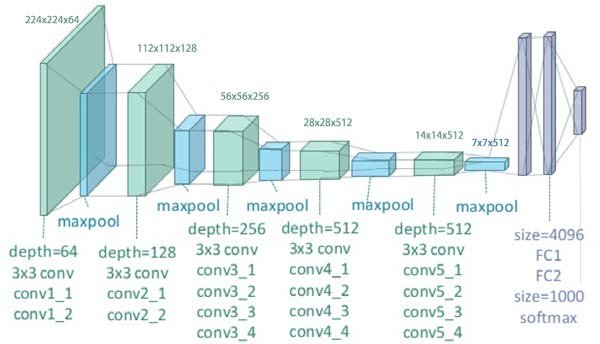

[1] “Illustration of the network architecture of VGG-19 model: conv means... | Download Scientific Diagram,” ResearchGate. Accessed: Mar. 31, 2024. [Online]. Available: https://www.researchgate.net/figure/llustration-of-the-network-architecture-of-VGG-19-model-conv-means-convolution-FC-means_fig2_325137356


As shown in the later experiments, the the first few layers are used to extract high-level features such as edges and textures. These layers will be used to compare style statistics. The final layers extract abstract/high-level features which will be used for representing the content statistics.


In [ ]:
# Creates a VGG model using Keras funtional API that returns a list of outputs from intermediate layers.
def vgg_layers(layer_names):
  # Load our model. Load pretrained VGG, trained on ImageNet data
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
  vgg.trainable = False

  outputs = [vgg.get_layer(name).output for name in layer_names]

  # To define a model using the functional API, specify the inputs and outputs:
  # Syntax: model = Model(inputs, outputs)
  model = tf.keras.Model([vgg.input], outputs)
  return model

## Set Up: Gram Loss (+ explain how loss is calculated)

The differences between the feature maps of content/style/output images must be aggregated into a metrics that can we can calculate loss on. As described in the tensorflow tutorial, the gram loss method uses the following procedure:


1.   Style layer outputs/feature maps are summarized using a gram matrix. As shown in the figure below, in essence, the gram matrix calculates the means/correlations across the feature maps by taking the average of all the elements in the outer product of the features vector with itself [2]. By calculating the gram matrix for the style layers, this can be used to represent a textural/style loss. However, it does not capture the full distribution of the feature map (discussed in more detail when implement Sliced Wasserstein loss) [3].
2.   `StyleContentModel` extracts style/content statistics. The mean square error (MSE) is calculated for two things. First, MSE between the image output style (gram matrix of style layers) relative to the style reference image's style (gram matrix of corresponding style layers). Second, MSE between content outputs (content layer feature maps of image output) relative to the original content image's content tensors.
3.   The weight sum of the style/content loss is taken based on linear combination weights `style_weight` and `content_weight`, then normalizing by number of content/style layers. Regularization using a total variation loss = `total_variation_weight` (used TF's standard implementation) removes high frequency image artifacts.


Code is commented below explaining each calculation in detail.

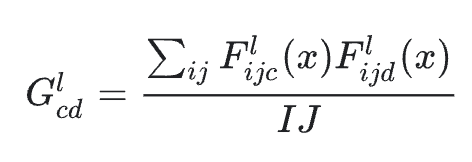

[2] “Neural style transfer | TensorFlow Core,” TensorFlow. Accessed: Mar. 31, 2024. [Online]. Available: https://www.tensorflow.org/tutorials/generative/style_transfer

[3] E. Heitz, K. Vanhoey, T. Chambon, and L. Belcour, “A Sliced Wasserstein Loss for Neural Texture Synthesis.” arXiv, Mar. 11, 2021. doi: 10.48550/arXiv.2006.07229.



TLDR; total loss is a multiobjective function

total loss to minimize = error of output image's style wrt style reference image + error of output image's content wrt original content image  + total variation loss

In [ ]:
# Gram matrix can be calculated for a feature map using tf.linalg.einsum
def gram_matrix(input_tensor):
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
  input_shape = tf.shape(input_tensor)
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
  return result/(num_locations)

In [ ]:
# Build a VGG model that returns the style and content statistics (directly returns outputs for content layers and returns gram matrix for style layers)
class StyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers):
    super(StyleContentModel, self).__init__()
    # Get the outputs for the style/content layers of the vgg model
    self.vgg = vgg_layers(style_layers + content_layers)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.vgg.trainable = False

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    # process inputs to feed into vgg model
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    # obtain outputs from intermediate layers (first layers for style and later layers for content)
    outputs = self.vgg(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                      outputs[self.num_style_layers:])

    # only the style outputs are turned into gram matrices
    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs]
    # content values are not turned into gram matrixes
    content_dict = {content_name: value
                    for content_name, value
                    in zip(self.content_layers, content_outputs)}

    style_dict = {style_name: value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

    return {'content': content_dict, 'style': style_dict}

Other than style/content/total variation weights, the number of training steps can also be adjusted (number of training steps = `num_steps` * `num_epochs`). For most experiments, the default number of training steps (1000) is used to consistently compare Gram vs Sliced Wasserstein.

In [ ]:
def train_gram(style_weight, content_weight, total_variation_weight, num_steps=100, num_epochs=10):
  # minimize MSE between image's output and each target (style_targets and content_targets)
  # goal is to match the content statistics of the content image and the style statistics of the style reference image
  def gram_loss(outputs, style_weight, content_weight):
      # calculate style/content of predicted image
      style_outputs = outputs['style']
      content_outputs = outputs['content']
      # calculate loss component = MSE between predicted image and style target
      # the style target is the style of the style_image
      style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2)
                            for name in style_outputs.keys()])
      style_loss *= style_weight / num_style_layers
      # calculate loss component = MSE between predicted image and content target
      # the content target is the content of the content_image
      content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2)
                              for name in content_outputs.keys()])
      content_loss *= content_weight / num_content_layers
      # combine the losses weighted by style/content weights
      loss = style_loss + content_loss
      return loss

  # Use tf.GradientTape to update the image (perform GD over the iamge -- move the image pixel values in the direction that minimizes MSE style/content)
  @tf.function()
  def train_step_gram(image_var, opt, style_weight, content_weight, total_variation_weight):
    # Record operations for automatic differentiation.
    with tf.GradientTape() as tape:
      outputs = gram_extractor(image_var)
      # calculate loss
      loss = gram_loss(outputs, style_weight, content_weight)
      # add regularization term to loss
      loss += total_variation_weight*tf.image.total_variation(image_var)
    grad = tape.gradient(loss, image_var)
    opt.apply_gradients([(grad, image_var)])
    image_var.assign(clip_0_1(image_var))

  opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
  start = time.time()
  epochs = num_epochs
  steps_per_epoch = num_steps

  step = 0
  for n in range(epochs):
    for m in range(steps_per_epoch):
      step += 1
      train_step_gram(image_var, opt, style_weight, content_weight, total_variation_weight)
      print(".", end='', flush=True)
    display.clear_output(wait=True)
    display.display(tensor_to_image(image_var))
    print("Train step: {}".format(step))

  end = time.time()
  print("Total time: {:.1f}".format(end-start))

  # Save result
  print(f"Hyperparameters: style_weight={style_weight}, content_weight={content_weight}, total_variation_weight={total_variation_weight}")
  date = datetime.datetime.now().strftime("%Y%m%d%H%M%S")
  file_name = f'gram-stylized-image-{date}.png'
  print(f'Saving {file_name}')
  tensor_to_image(image_var).save(file_name)

  try:
    from google.colab import files
  except ImportError:
    pass
  else:
    files.download(file_name)

## Set Up: Sliced Wasserstein Loss (SWL) (+ explain how loss is calculated)

 The disadvantage of the Gram loss is that it only calculates differences between major directions of the feature map distribution (i.e. since based on mean/correlations, in 2D it measures distributions as ellipses as shown in Figure 1 [3]).

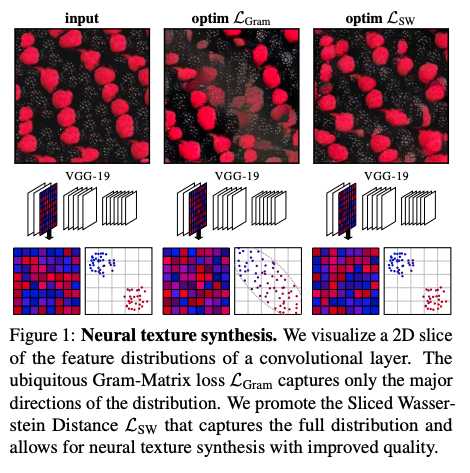

The Sliced Wasserstein Loss captures the full distribution by randomly projecting n-dimensional features onto random directions, sorting the projections, then calculating the L2 distance between the sorted lists (Figure 2 [3]). This loss is summed over the style layers to produce a total style loss.

In the loss function below, the content loss is still measured as MSE between the content target and content output. According to [3] Sliced Wasserstein loss is best at representing textural loss. MSE was used for content loss to ensure the output image still looked like the content image.

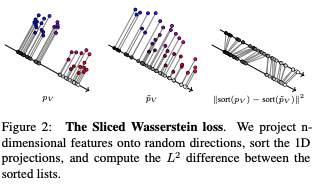

[3] E. Heitz, K. Vanhoey, T. Chambon, and L. Belcour, “A Sliced Wasserstein Loss for Neural Texture Synthesis.” arXiv, Mar. 11, 2021. doi: 10.48550/arXiv.2006.07229.

In [ ]:
# Build a VGG model that returns the style and content statistics (directly returns outputs for content layers and returns gram matrix for style layers)
class WassersteinStyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers):
    super(WassersteinStyleContentModel, self).__init__()
    # Get the outputs for the style/content layers of the vgg model
    self.vgg = vgg_layers(style_layers + content_layers)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.vgg.trainable = False

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    # process inputs to feed into vgg model
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    # obtain outputs from intermediate layers (first layers for style and later layers for content)
    outputs = self.vgg(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                      outputs[self.num_style_layers:])

    # content AND style values are not turned into gram matrixes
    content_dict = {content_name: value
                    for content_name, value
                    in zip(self.content_layers, content_outputs)}

    style_dict = {style_name: value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}

    return {'content': content_dict, 'style': style_dict}

Like gram loss, still uses `style_weight`, `content_weight` and `total_variation_weight` in the loss function. Loss is not normalized by number of layers (found that doing this worsened results). Number of training steps = `num_steps` * `num_epochs`

In [ ]:
def train_wasserstein(style_weight, content_weight, total_variation_weight, num_steps=100, num_epochs=10):
  # goal is to match the content statistics of the content image and the style statistics of the style reference image
  def slicing_loss(outputs, style_weight, content_weight):
    # calculate style/content of predicted image
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    # reshape activation outputs to calculate sliced wasserstein loss over layers
    list_activations_generated = []
    # the style/content statistics of the output image
    for item in style_outputs.keys():
        list_activations_generated.append(style_outputs[item])
    for item in content_outputs.keys():
        list_activations_generated.append(content_outputs[item])
    # [3] Sliced Wasserstein loss as the sum over the layers -- iterate over layers to calculate total style loss
    style_loss = 0
    for l in range(num_style_layers):
        # get dimensions
        b = tf.shape(list_activations_example[l])[0]
        dim = tf.shape(list_activations_example[l])[1]
        n = tf.shape(list_activations_example[l])[2] * tf.shape(list_activations_example[l])[3]
        # linearize layer activations
        activations_example = tf.reshape(list_activations_example[l], (b, dim, n))
        activations_generated = tf.reshape(list_activations_generated[l], (b, dim, n))
        # Calculate style loss using Sliced Wasserstein method shown in Figure 2 of [3]
        Ndirection = dim
        # sample n-random directions
        directions = tf.random.normal((Ndirection, dim))
        directions = directions / tf.sqrt(tf.reduce_sum(directions**2, axis=1, keepdims=True))
        # project activations over random directions (according to Figure 2 in [3], project n-dimensional features onto random directions)
        projected_activations_example = tf.einsum('bdn,md->bmn', activations_example, directions)
        projected_activations_generated = tf.einsum('bdn,md->bmn', activations_generated, directions)
        # sort the 1D projections
        sorted_activations_example = tf.sort(projected_activations_example, axis=2)[0]
        sorted_activations_generated = tf.sort(projected_activations_generated, axis=2)[0]
        # calculate L2 difference between sorted lists
        if l < num_style_layers:
          style_loss += tf.reduce_mean(tf.square(sorted_activations_example - sorted_activations_generated))

    # calculate loss = MSE between predicted image and content target
    # the content target is the content of the content_image
    content_loss = 0
    content_loss += tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2)
                            for name in content_outputs.keys()])
    # loss is weighted sum of style and content loss
    style_loss *= style_weight
    content_loss *= content_weight
    loss = style_loss + content_loss

    return loss

  # Use tf.GradientTape to update the image (perform GD over the iamge -- move the image pixel values in the direction that minimizes MSE style/content)
  @tf.function()
  def train_step_wasserstein(image_var, style_weight, content_weight, total_variation_weight):
    # Record operations for automatic differentiation.
    with tf.GradientTape() as tape:
      outputs = wasserstein_extractor(image_var)
      # calculate loss
      loss = slicing_loss(outputs, style_weight, content_weight)
      # add regularization term to loss
      loss += total_variation_weight*tf.image.total_variation(image_var)

    grad = tape.gradient(loss, image_var)
    opt.apply_gradients([(grad, image_var)])
    image_var.assign(clip_0_1(image_var))

  opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
  start = time.time()
  epochs = num_epochs
  steps_per_epoch = num_steps

  step = 0
  for n in range(epochs):
    for m in range(steps_per_epoch):
      step += 1
      train_step_wasserstein(image_var, style_weight, content_weight, total_variation_weight)
      print(".", end='', flush=True)
    display.clear_output(wait=True)
    display.display(tensor_to_image(image_var))
    print("Train step: {}".format(step))

  end = time.time()
  print("Total time: {:.1f}".format(end-start))

  # Save result
  print(f"Hyperparameters: style_weight={style_weight}, content_weight={content_weight}, total_variation_weight={total_variation_weight}")
  date = datetime.datetime.now().strftime("%Y%m%d%H%M%S")
  file_name = f'wasserstein-stylized-image-{date}.png'
  print(f'Saving {file_name}')
  tensor_to_image(image_var).save(file_name)

  try:
    from google.colab import files
  except ImportError:
    pass
  else:
    files.download(file_name)


## Experiment Controls

1. All models trained in the same way (i.e. using same optimizer Adam, same input image processing, etc). Note the tutorial used Adam but as described below, papers recommend LBFGS. This is discussed later in results. Ultimately Adam was chosen since it require less compute resources and was faster.
2. Only difference is how loss is calculated (Gram loss or Sliced Wasserstein loss)
3. Between experiments, single parameters are changed (i.e. increment weights or change epochs) to isolate effects.

## Brief Description of Metrics



Besides visual inspection, two numerical metrics are used below to compare image quality: structural similarity for style/content similarity and L2 distance for measuring content similarity.

1.   Structural Similarity Index (SSIM): MSE alone cannot indicate image similarity. Structural similarity also takes into account texture/style of images. SSIM index is calculated by using a slide square window over an image. The SSIM index is calculated from each window using the mean and variance of the pixel values in order to capture the luminance (average over all pixel values), contrast (std dev of pixel values), and structure ((pixel-mean)/stdev) of the image. An index of +1 indicates high similarity and -1 means they are very different [4]. `  return {'content_ssim': c_sim, 'style_ssim': s_sim, 'content_style_ratio': c_sim/s_sim}` --> note that the 3rd value returned is ratio of content to style to assess relative metrics.
2.   Li et al content and style distance defines content and style distance metrics to assess style transfer. The content distance is defined in equation (1) the Euclidean distance between the feature maps of content layers. The style distance is taken for a style layer by randomly sampling 2000 activations and taking an average wasserstein distance to determine how different the feature map distributions are. Only the content distance is implemented below since SSIM already takes into acount style/content [5]. `return { 'content_loss_l2': content_loss }`

[4] P. Datta, “All about Structural Similarity Index (SSIM): Theory + Code in PyTorch,” SRM MIC. Accessed: Mar. 31, 2024. [Online]. Available: https://medium.com/srm-mic/all-about-structural-similarity-index-ssim-theory-code-in-pytorch-6551b455541e

[5] J. Li, D. Xu, and S. Yao, “Sliced Wasserstein Distance for Neural Style Transfer,” Computers & Graphics, vol. 102, pp. 89–98, Feb. 2022, doi: 10.1016/j.cag.2021.12.004.

For the most important experiments, numerical metrics are used for further comparison. Visual inspection is the primary method of comparison.

In [ ]:
def plot_compare(content_image, style_image, output_image):
  plt.figure()
  plt.subplot(1, 3, 1)
  imshow(content_image, 'Content Image')

  plt.subplot(1, 3, 2)
  imshow(style_image, 'Style Image')

  plt.subplot(1, 3, 3)
  imshow(output_image, 'Output Image')

# Define SSIM index for content and style [4]
def structural_sim(output_path, ci_path, si_path):
  output = load_img(output_path)
  ci = load_img(ci_path)
  si = load_img(si_path)

  output = np.squeeze(output.numpy())
  ci = np.squeeze(ci.numpy())
  si = np.squeeze(si.numpy())
  plot_compare(ci, si, output)

  c_sim = ssim(output, ci, channel_axis=2)
  s_sim = ssim(output, si, channel_axis=2)

  return {'content_ssim': c_sim, 'style_ssim': s_sim, 'content_style_ratio': c_sim/s_sim}

# "The content loss is usually defined as the Euclidean distance between the feature maps in selected layers [5]"
def content_distance_li_et_al(output_path, ci_path, si_path):
  output = load_img(output_path)
  ci = load_img(ci_path)
  si = load_img(si_path)

  content_layers = ['block5_conv2']
  content_extractor = vgg_layers(content_layers)
  content_targets = content_extractor(ci*255.0)
  content_outputs = content_extractor(output*255.0)

  for name, target in zip(content_layers, content_targets):
    for name, output in zip(content_layers, content_outputs):
      content_loss = tf.norm(output-target, ord='euclidean').numpy()

  return { 'content_loss_l2': content_loss }


## Gram vs Sliced Wasserstein (Yellow Labrador x Kandinsky)

195196/195196 [==============================] - 1s 3us/step


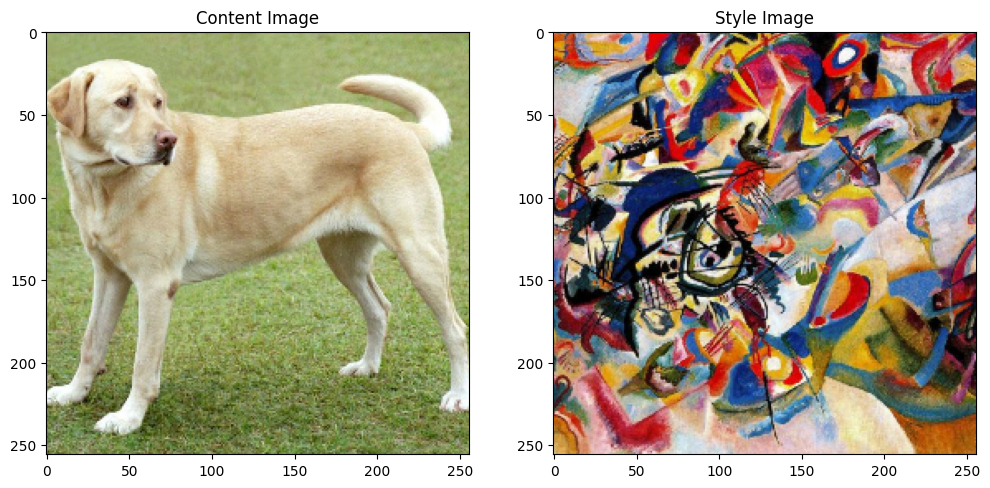

In [ ]:
content_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
style_path = tf.keras.utils.get_file('kandinsky5.jpg','https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg')

content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

### Experiment 1.1 - Gram (balancing content/style weights)

In [ ]:
# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1',
                'block4_conv1',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (gram matrix style and content)
gram_extractor = StyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = gram_extractor(style_image)['style']
content_targets = gram_extractor(content_image)['content']

print(style_targets.keys())

80134624/80134624 [==============================] - 0s 0us/step
dict_keys(['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1'])


#### Test increasing style weight

Content becomes less defined.

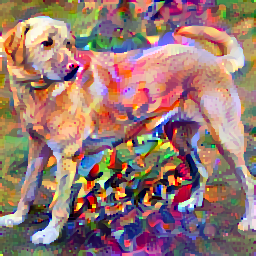

Train step: 1000
Total time: 27.5
Hyperparameters: style_weight=0.0001, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240330185842.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-4, 1e3, 30)

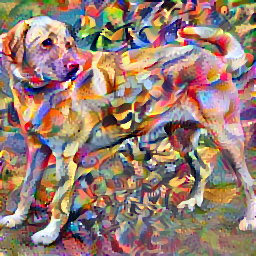

Train step: 1000
Total time: 27.7
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240330185718.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 30)

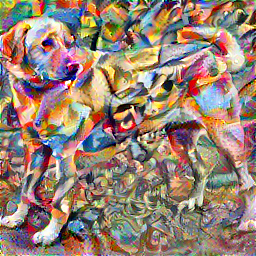

Train step: 1000
Total time: 28.5
Hyperparameters: style_weight=0.01, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240330185746.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-2, 1e3, 30)

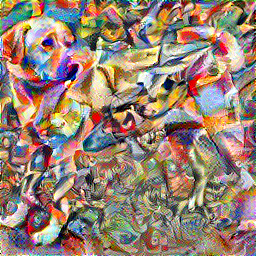

Train step: 1000
Total time: 27.9
Hyperparameters: style_weight=0.1, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240330185814.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-1, 1e3, 30)

#### Test increasing content weight

Not enough style.

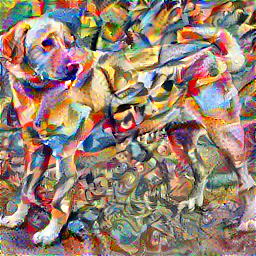

Train step: 1000
Total time: 27.3
Hyperparameters: style_weight=0.01, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240330185143.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Define a tf.Variable to contain the image to optimize - maintains shared, persistent state
image_var = tf.Variable(content_image)
train_gram(1e-2, 1e3, 30)

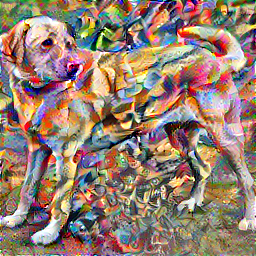

Train step: 1000
Total time: 28.2
Hyperparameters: style_weight=0.01, content_weight=10000.0, total_variation_weight=30
Saving gram-stylized-image-20240330185220.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-2, 1e4, 30)

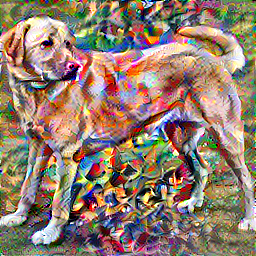

Train step: 1000
Total time: 27.9
Hyperparameters: style_weight=0.01, content_weight=100000.0, total_variation_weight=30
Saving gram-stylized-image-20240330185248.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-2, 1e5, 30)

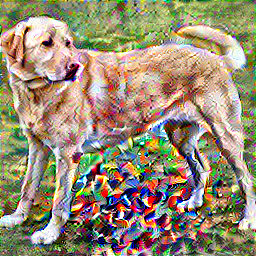

Train step: 1000
Total time: 27.7
Hyperparameters: style_weight=0.01, content_weight=1000000.0, total_variation_weight=30
Saving gram-stylized-image-20240330185316.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-2, 1e6, 30)

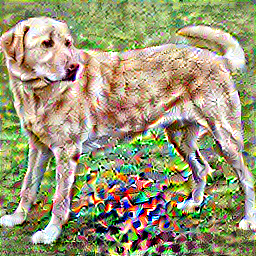

Train step: 1000
Total time: 28.4
Hyperparameters: style_weight=0.01, content_weight=10000000.0, total_variation_weight=30
Saving gram-stylized-image-20240330185344.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-2, 1e7, 30)

#### Test increasing regularization

Remove HF artifacts, more defined edges. Difference not extremely noticable.

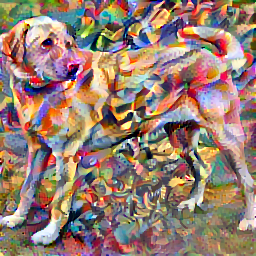

Train step: 1000
Total time: 28.0
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=20
Saving gram-stylized-image-20240330190152.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 20)

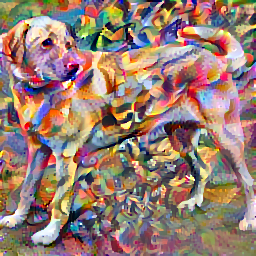

Train step: 1000
Total time: 27.8
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240330190220.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 30)

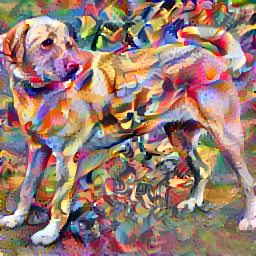

Train step: 1000
Total time: 27.4
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=40
Saving gram-stylized-image-20240330190247.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 40)

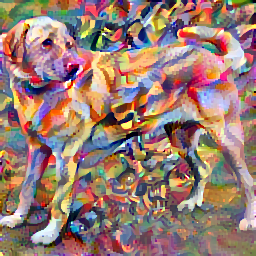

Train step: 1000
Total time: 29.4
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=50
Saving gram-stylized-image-20240330190316.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 50)

### Experiment 1.2 - Sliced Wasserstein (balancing content/style weights)

Use same content/style layers, number of training steps, and same training process; but use SWL and adjust content/style weights.

In [ ]:
# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1',
                'block4_conv1',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs
wasserstein_extractor = WassersteinStyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = wasserstein_extractor(style_image)['style']
content_targets = wasserstein_extractor(content_image)['content']

# reshape outputs to calculate SWD
list_activations_example = []
for item in style_targets.keys():
  list_activations_example.append(style_targets[item])
for item in content_targets.keys():
  list_activations_example.append(content_targets[item])


80134624/80134624 [==============================] - 4s 0us/step


#### Test increasing style weight

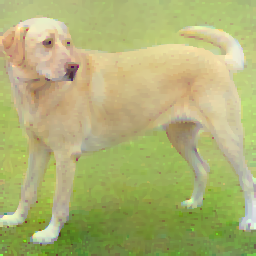

Train step: 1000
Total time: 46.7
Hyperparameters: style_weight=0.01, content_weight=1000.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240330212856.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e-2, 1e3, 30)

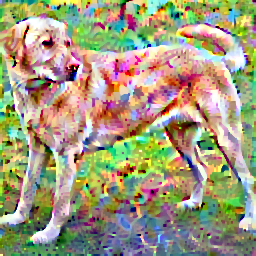

Train step: 1000
Total time: 47.1
Hyperparameters: style_weight=100.0, content_weight=1000.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240330212943.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e2, 1e3, 30)

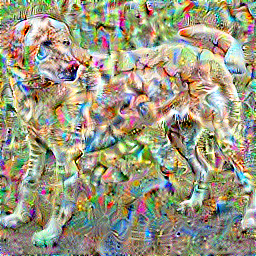

Train step: 1000
Total time: 48.0
Hyperparameters: style_weight=10000.0, content_weight=1000.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240330213031.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e4, 1e3, 30)

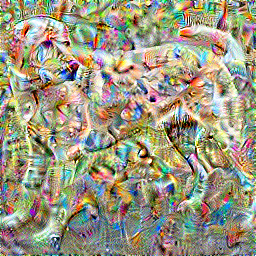

Train step: 1000
Total time: 48.4
Hyperparameters: style_weight=1000000.0, content_weight=1000.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240330213120.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e6, 1e3, 30)

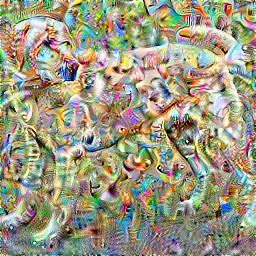

Train step: 1000
Total time: 47.7
Hyperparameters: style_weight=100000000.0, content_weight=1000.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240330213208.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e3, 30)

#### Test increasing content weight

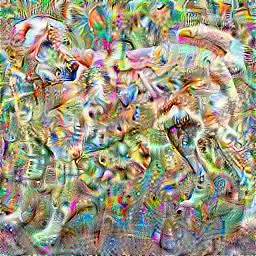

Train step: 1000
Total time: 49.9
Hyperparameters: style_weight=100000000.0, content_weight=0.1, total_variation_weight=30
Saving wasserstein-stylized-image-20240401140317.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e-1, 30)

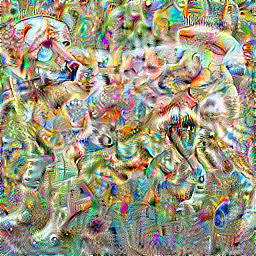

Train step: 1000
Total time: 47.2
Hyperparameters: style_weight=100000000.0, content_weight=1, total_variation_weight=30
Saving wasserstein-stylized-image-20240401140404.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1, 30)

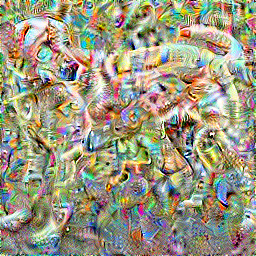

Train step: 1000
Total time: 47.4
Hyperparameters: style_weight=100000000.0, content_weight=100.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240401140451.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e2, 30)

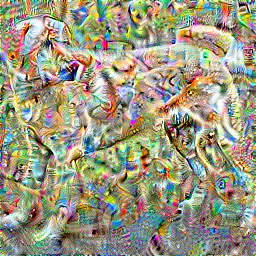

Train step: 1000
Total time: 47.8
Hyperparameters: style_weight=100000000.0, content_weight=10000.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240401140539.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e4, 30)

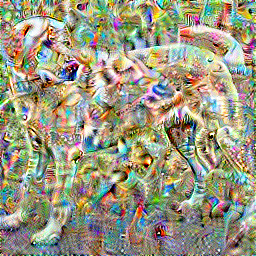

Train step: 1000
Total time: 47.5
Hyperparameters: style_weight=100000000.0, content_weight=1000000.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240401140627.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e6, 30)

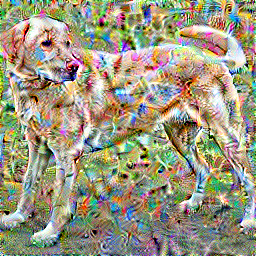

Train step: 1000
Total time: 47.5
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240401140714.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 30)

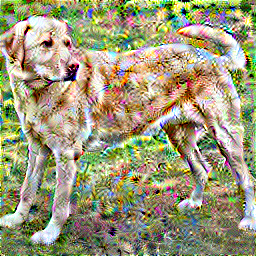

Train step: 1000
Total time: 47.6
Hyperparameters: style_weight=100000000.0, content_weight=10000000000.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240401140802.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e10, 30)

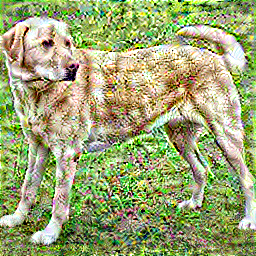

Train step: 1000
Total time: 47.5
Hyperparameters: style_weight=100000000.0, content_weight=1000000000000.0, total_variation_weight=30
Saving wasserstein-stylized-image-20240401140850.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e12, 30)

#### Test increasing regularization

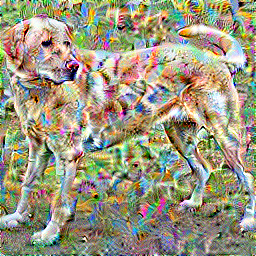

Train step: 1000
Total time: 46.6
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=0
Saving wasserstein-stylized-image-20240330214401.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 0)

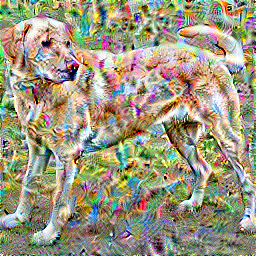

Train step: 1000
Total time: 47.5
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=20
Saving wasserstein-stylized-image-20240330214448.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 20)

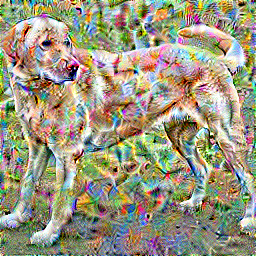

Train step: 1000
Total time: 47.8
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=40
Saving wasserstein-stylized-image-20240330214536.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 40)

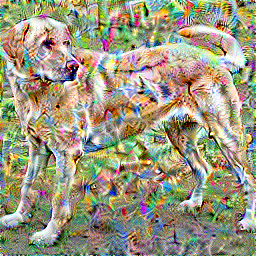

Train step: 1000
Total time: 47.5
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=50
Saving wasserstein-stylized-image-20240401140937.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 50)

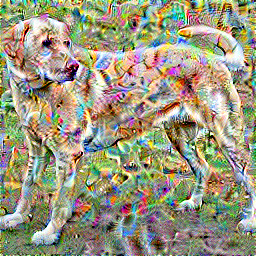

Train step: 1000
Total time: 48.2
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=60
Saving wasserstein-stylized-image-20240330214624.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 60)

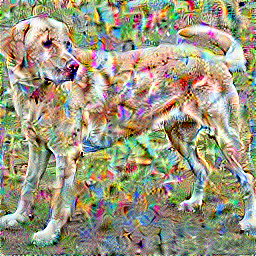

Train step: 1000
Total time: 47.7
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=80
Saving wasserstein-stylized-image-20240330214712.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 80)

### Experiment 2.1 - Gram (different convolutional layers and number of layers)

Use all layers across content/style layers.

In [ ]:
# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (gram matrix style and content)
gram_extractor = StyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = gram_extractor(style_image)['style']
content_targets = gram_extractor(content_image)['content']

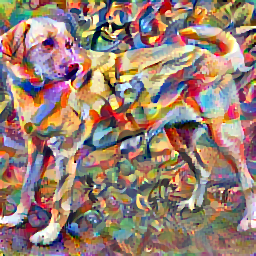

Train step: 1000
Total time: 39.4
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240330211618.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Based on visual inspection, use the best weights from Experiment 1.1
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 30)

Remove some intermediate style layers which are closer to the content layers.

In [ ]:
# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (gram matrix style and content)
gram_extractor = StyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = gram_extractor(style_image)['style']
content_targets = gram_extractor(content_image)['content']

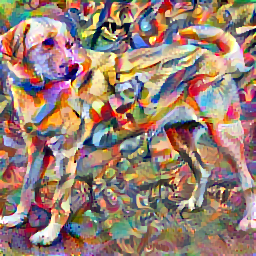

Train step: 1000
Total time: 37.0
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240331223238.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Based on visual inspection, use the best weights from Experiment 1.1
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 30)

### Experiment 2.2 - Sliced Wasserstein (different convolutional layers and number of layers)

Use all layers across content/style layers.

In [ ]:
# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (just get unmodified activation outputs/feature maps)
# no gram matrix!
wasserstein_extractor = WassersteinStyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = wasserstein_extractor(style_image)['style']
content_targets = wasserstein_extractor(content_image)['content']

list_activations_example = []
for item in style_targets.keys():
  # print(item)
  list_activations_example.append(style_targets[item])
for item in content_targets.keys():
  # print(item)
  list_activations_example.append(content_targets[item])


80134624/80134624 [==============================] - 4s 0us/step


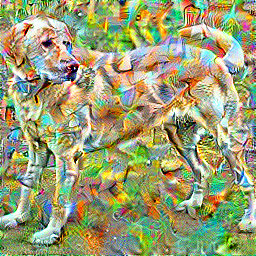

Train step: 1000
Total time: 79.8
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=50
Saving wasserstein-stylized-image-20240330212747.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 50)

Remove some intermediate style layers which are closer to the content layers.

In [ ]:
# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (just get unmodified activation outputs/feature maps)
# no gram matrix!
wasserstein_extractor = WassersteinStyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = wasserstein_extractor(style_image)['style']
content_targets = wasserstein_extractor(content_image)['content']

list_activations_example = []
for item in style_targets.keys():
  # print(item)
  list_activations_example.append(style_targets[item])
for item in content_targets.keys():
  # print(item)
  list_activations_example.append(content_targets[item])


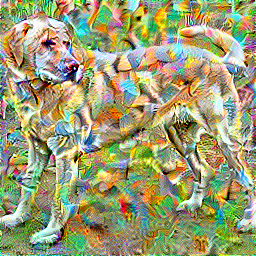

Train step: 1000
Total time: 76.8
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=50
Saving wasserstein-stylized-image-20240401142939.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 50)

### Experiment 3.1 - Gram (All layers, More training steps)

Based on experiment 2.1 all layers.

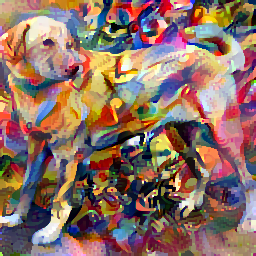

Train step: 10000
Total time: 345.6
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240331011733.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# EXPERIMENT 2.1

# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (gram matrix style and content)
gram_extractor = StyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = gram_extractor(style_image)['style']
content_targets = gram_extractor(content_image)['content']

# Based on visual inspection, use the best weights from Experiment 1.1
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 30, 100, 100)

### Experiment 3.2 - Sliced Wasserstein (All layers, More training steps)

Based on experiment 2.2 all layers.

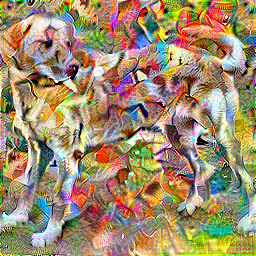

Train step: 10000
Total time: 772.5
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=50
Saving wasserstein-stylized-image-20240401042738.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# EXPERIMENT 2.2

# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (just get unmodified activation outputs/feature maps)
# no gram matrix!
wasserstein_extractor = WassersteinStyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = wasserstein_extractor(style_image)['style']
content_targets = wasserstein_extractor(content_image)['content']

list_activations_example = []
for item in style_targets.keys():
  # print(item)
  list_activations_example.append(style_targets[item])
for item in content_targets.keys():
  # print(item)
  list_activations_example.append(content_targets[item])


image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 50, 100)

### Metrics (comparing Gram vs SWL from experiments 2.1 and 2.2) and Summary of Visual Inspection

Numerical statistics are calculated for the trial with the best Wasserstein and Gram images. The images use the same layers/epochs/style weights in order to control and assess the performance of Gram vs Wasserstein.

In [ ]:
content_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
style_path = tf.keras.utils.get_file('kandinsky5.jpg','https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg')


#### Experiment 2.1, all layers, gram-stylized-image-20240330211618.png

{'content_ssim': 0.3160284,
 'style_ssim': 0.101505674,
 'content_style_ratio': 3.1134062}

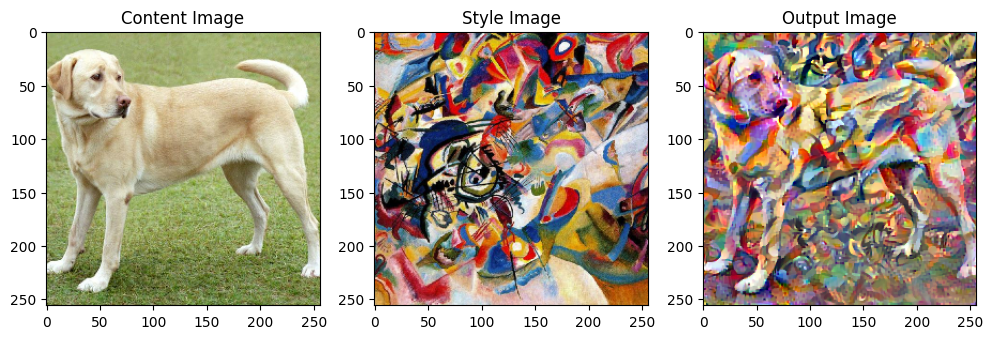

In [ ]:
output_path = 'gram-stylized-image-20240330211618.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

{'content_loss_l2': 23378.436}

#### Experiment 2.2, all layers, wasserstein-stylized-image-20240330212747.png

{'content_ssim': 0.22199173,
 'style_ssim': 0.06747342,
 'content_style_ratio': 3.290062}

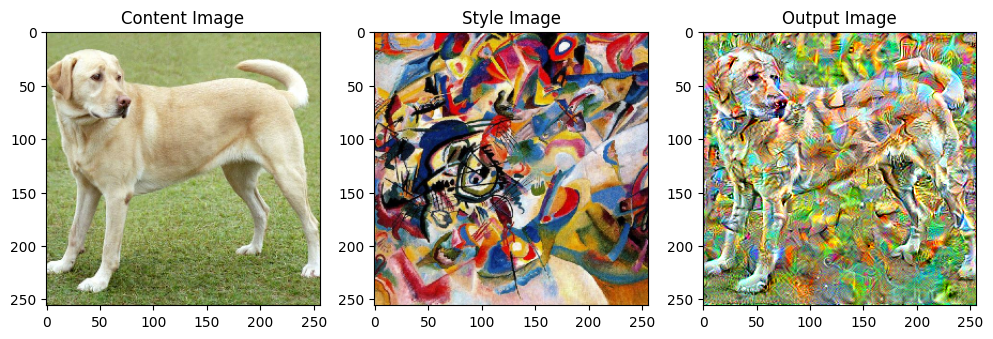

In [ ]:
output_path = 'wasserstein-stylized-image-20240330212747.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

{'content_loss_l2': 24304.996}

#### Experiment 3.1, all layers, more training steps (10000)

{'content_ssim': 0.3037024,
 'style_ssim': 0.10440057,
 'content_style_ratio': 2.9090111}

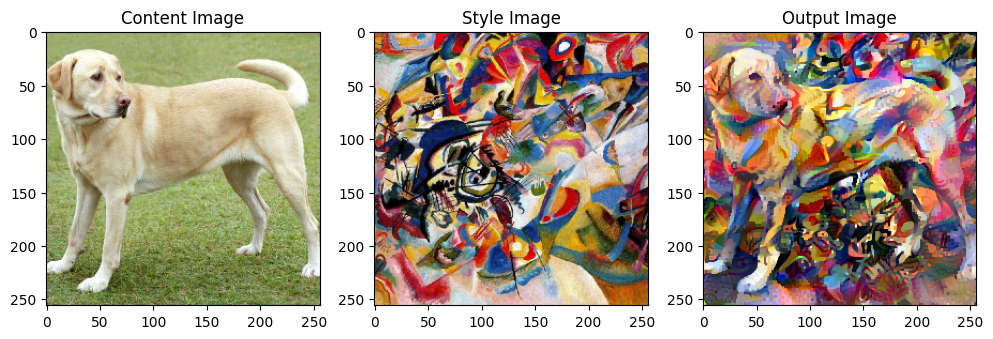

In [ ]:
output_path = 'gram-stylized-image-20240331011733.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

{'content_loss_l2': 22534.041}

#### Experiment 3.2, all layers, more training steps (10000)

{'content_ssim': 0.16124873,
 'style_ssim': 0.07130021,
 'content_style_ratio': 2.2615464}

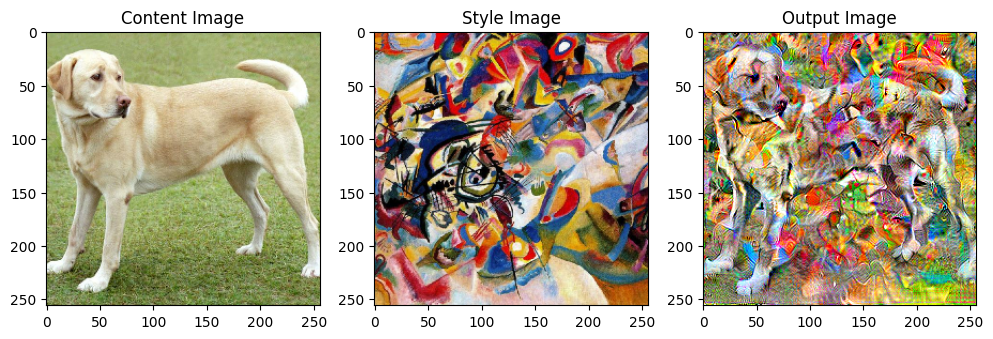

In [ ]:
output_path = 'wasserstein-stylized-image-20240401042738.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

{'content_loss_l2': 22043.305}

#### Description of Results

Visually inspecting across experiments 1.1 to 3.1 shows that the gram and SWL methods produce outputs which resemble the content image with the provided style. As style weight increases in experiment 1.1-1.2, the style becomes more heavy (the content image is less defined). As content weight increases, the images more closely resembles the original image. Regularization sometimes helped remove high frequency artifacts.

Experiment 2.1 and 2.2 used the weights from Experiment 1.1/1.2 that produced the most visually appealing balance of style and content.

For the gram method, using more layers in Experiment 2.1 changed the image slightly. Using more content/style layers made the brush strokes more defined. However, using all layers vs removing only a few intermediate layers didn't make much difference in experiment 2.1.

Experiment 2.2 used more layers and the SW loss function. Visually, the experiment using all layers (wasserstein-stylized-image-20240330212747.png) looked the best. The image of the dog was clear with a texture of paint strokes.

Experiments 3 used more epochs. More epochs did make the shape of the dog more defined with clearer edges, especially in the gram method. More epochs also helped the SWL method converge to an image with "stronger" edges and a clearer dog content. The colours also tended to be brighter.

-----

Based on numeric metrics, the gram method in experiment 2.1 had a higher SSIM index for both content and style compared to experiment 2.2. This implies that the gram method performed better. This was expected since the optimal style/content weights for wasserstein were found to both be 1e8. This would make the image more "style heavy" compared to gram. The L2 content distance was also higher in experiment 2.2 than 2.1 which agrees with the SSIM index metrics (i.e. wasserstein did better at capturing style than preserving content).

Comparing 2.1 vs 3.1, when content similarity decreases (0.3160284 to 0.3037024), style similarity increases (0.101505674 to 0.10440057). A similar pattern is found when comparing 2.2 vs 3.2 (content similarity decreases from 0.22199173 to 0.16124873 and style similatiry increases from 0.06747342 to 0.07130021). This shows the trade off between style adn content similarity. Based on SSIM index, more epochs tends to increase style similarity and decrease content similarity. Moreover, visually the images match the style slightly better with more epochs. Finally, experiment 3.2 had a lower content to style SSIM ratio compared to experiment 3.1. This may imply that wasserstein was better at capturing style overall (i.e. relative to content, captured more style).


## Gram vs Sliced Wasserstein (Belfry/Minion x New Style)

### Results

108525/108525 [==============================] - 0s 2us/step


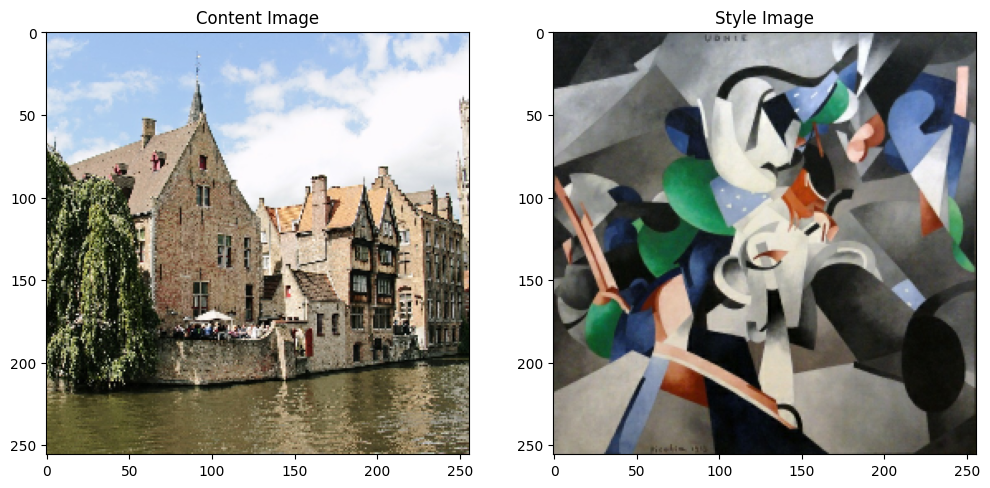

In [ ]:
content_path = tf.keras.utils.get_file('belfry.jpg','https://storage.googleapis.com/khanhlvg-public.appspot.com/arbitrary-style-transfer/belfry-2611573_1280.jpg')
style_path = tf.keras.utils.get_file('style23.jpg','https://storage.googleapis.com/khanhlvg-public.appspot.com/arbitrary-style-transfer/style23.jpg')

content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

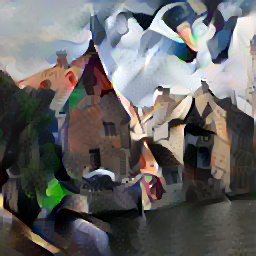

Train step: 5000
Total time: 169.2
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240331014357.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# EXPERIMENT 2.1

# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (gram matrix style and content)
gram_extractor = StyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = gram_extractor(style_image)['style']
content_targets = gram_extractor(content_image)['content']

# Based on visual inspection, use the best weights from Experiment 1.1
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 30, 500)

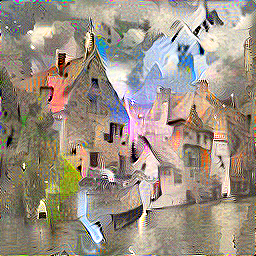

Train step: 10000
Total time: 769.4
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=50
Saving wasserstein-stylized-image-20240401052738.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# EXPERIMENT 2.2

# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (just get unmodified activation outputs/feature maps)
# no gram matrix!
wasserstein_extractor = WassersteinStyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = wasserstein_extractor(style_image)['style']
content_targets = wasserstein_extractor(content_image)['content']

list_activations_example = []
for item in style_targets.keys():
  # print(item)
  list_activations_example.append(style_targets[item])
for item in content_targets.keys():
  # print(item)
  list_activations_example.append(content_targets[item])


image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 50, 100)

   8192/Unknown - 0s 0us/step

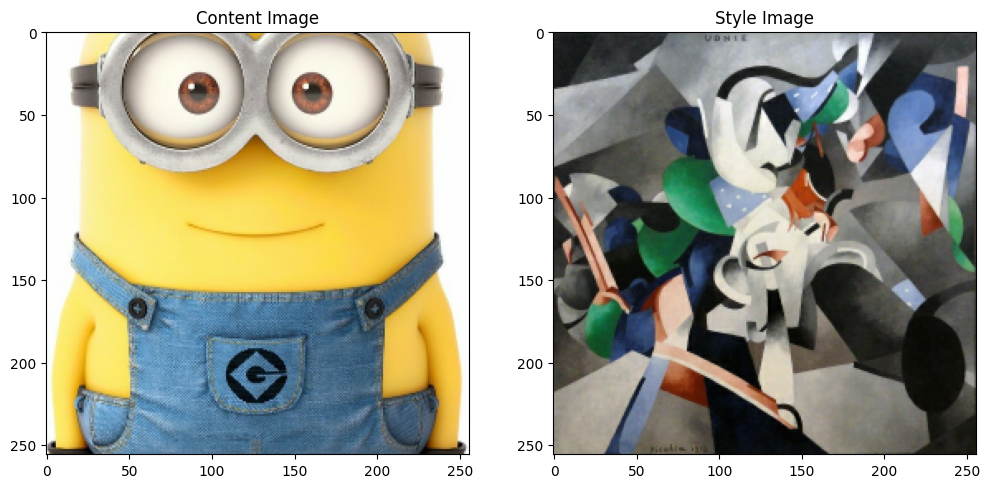

In [ ]:
content_path = tf.keras.utils.get_file('minon.jpg','https://i1.sndcdn.com/artworks-EtyDSA7Lz55JVNmo-zbagBw-t500x500.jpg')
style_path = tf.keras.utils.get_file('style23.jpg','https://storage.googleapis.com/khanhlvg-public.appspot.com/arbitrary-style-transfer/style23.jpg')

content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

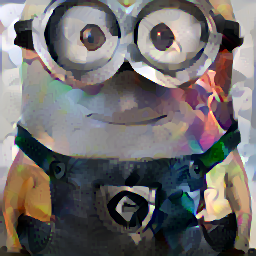

Train step: 5000
Total time: 179.1
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240331215902.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# EXPERIMENT 2.1

# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (gram matrix style and content)
gram_extractor = StyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = gram_extractor(style_image)['style']
content_targets = gram_extractor(content_image)['content']

# Based on visual inspection, use the best weights from Experiment 1.1
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 30, 500)

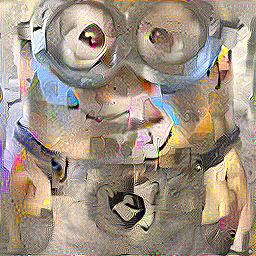

Train step: 10000
Total time: 772.4
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=50
Saving wasserstein-stylized-image-20240401054031.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# EXPERIMENT 2.2

# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (just get unmodified activation outputs/feature maps)
# no gram matrix!
wasserstein_extractor = WassersteinStyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = wasserstein_extractor(style_image)['style']
content_targets = wasserstein_extractor(content_image)['content']

list_activations_example = []
for item in style_targets.keys():
  # print(item)
  list_activations_example.append(style_targets[item])
for item in content_targets.keys():
  # print(item)
  list_activations_example.append(content_targets[item])


image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 50, 100)

### Metrics (comparing Gram vs SWD) and Summary of Visual Inspection (Belfry content image)

A new content/style image are used in these trials.

In [ ]:
content_path = tf.keras.utils.get_file('belfry.jpg','https://storage.googleapis.com/khanhlvg-public.appspot.com/arbitrary-style-transfer/belfry-2611573_1280.jpg')
style_path = tf.keras.utils.get_file('style23.jpg','https://storage.googleapis.com/khanhlvg-public.appspot.com/arbitrary-style-transfer/style23.jpg')


108525/108525 [==============================] - 0s 3us/step


{'content_ssim': 0.37775016,
 'style_ssim': 0.2612197,
 'content_style_ratio': 1.4461013}

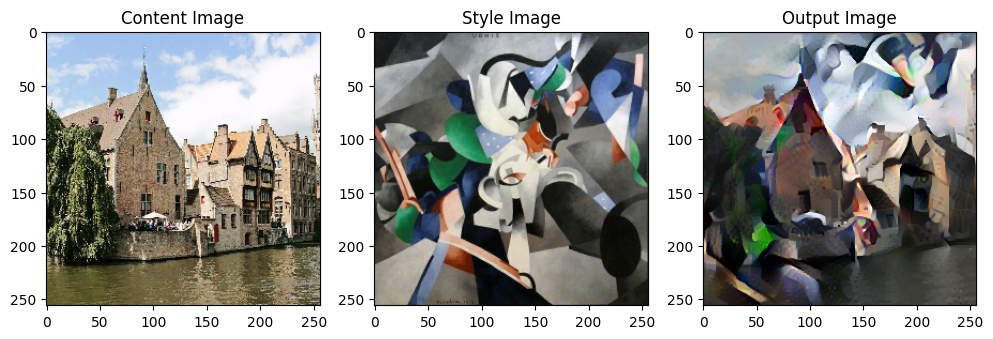

In [ ]:
output_path = 'gram-stylized-image-20240331014357.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

80134624/80134624 [==============================] - 5s 0us/step


{'content_loss_l2': 19391.734}

{'content_ssim': 0.21250074,
 'style_ssim': 0.14261809,
 'content_style_ratio': 1.4899985}

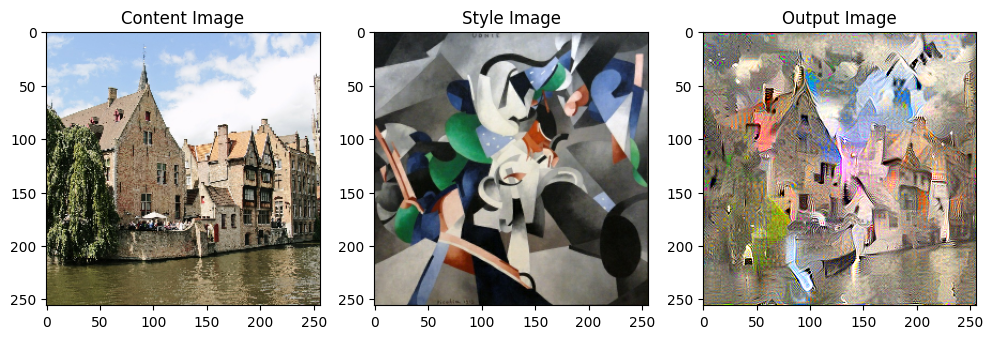

In [ ]:
output_path = 'wasserstein-stylized-image-20240401052738.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

{'content_loss_l2': 17947.979}

#### Description of Results

Given a new content image (belfy/building) with lots of straight edges and defined shapes worked well for the style images. Similar numerical metric results as the labrador. I find tha the wasserstein method tends to make images look more like paintings, with more abstract brush strokes.

### Metrics (comparing Gram vs SWD) and Summary of Visual Inspection (Minion content image)

A new content/style image are used in these trials.

In [ ]:
content_path = tf.keras.utils.get_file('minion.jpg','https://i1.sndcdn.com/artworks-EtyDSA7Lz55JVNmo-zbagBw-t500x500.jpg')
style_path = tf.keras.utils.get_file('style23.jpg','https://storage.googleapis.com/khanhlvg-public.appspot.com/arbitrary-style-transfer/style23.jpg')


   8192/Unknown - 0s 0us/step

{'content_ssim': 0.484095,
 'style_ssim': 0.22218461,
 'content_style_ratio': 2.1787963}

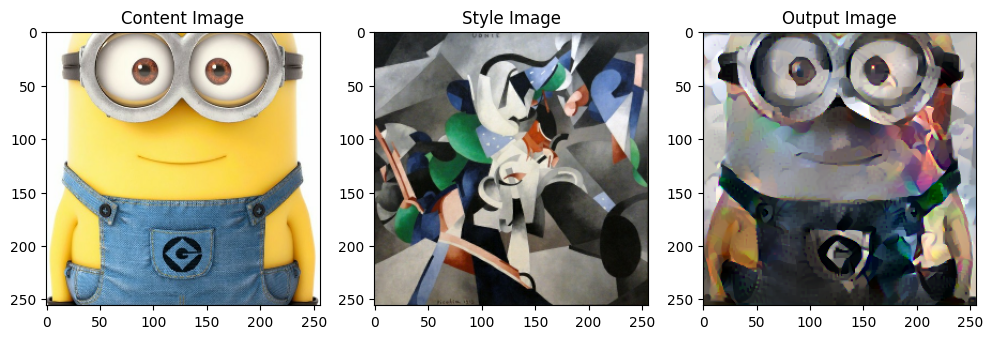

In [ ]:
output_path = 'gram-stylized-image-20240331215902.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

{'content_loss_l2': 21361.125}

{'content_ssim': 0.23822987,
 'style_ssim': 0.12355831,
 'content_style_ratio': 1.9280764}

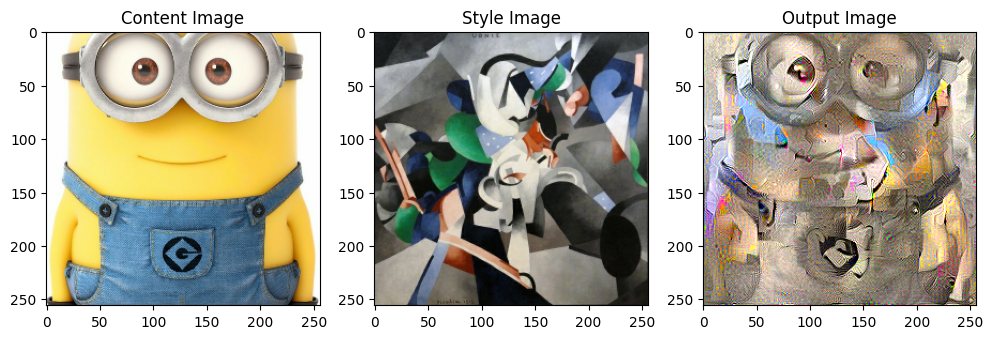

In [ ]:
output_path = 'wasserstein-stylized-image-20240401054031.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

{'content_loss_l2': 22218.318}

#### Description of Results

Again, very similar results to belfry; wasserstein produces more abstract style images (but content is still clear which is good). The wasserstein colours are generally more dull/muted. The minion also seems more difficult to paint in the style due it's very pale yellow colour that takes up the majority of the space. Visually, I don't think the gram looks very much like the style image as it looks very similar to the content image.

## Gram vs Sliced Wasserstein (Belfry/Minion x Monet Style)

### Results

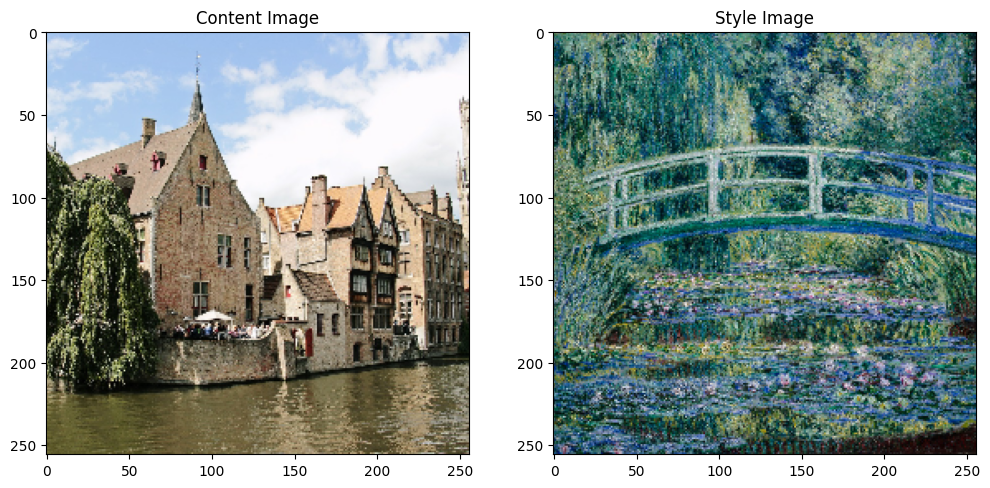

In [ ]:
content_path = tf.keras.utils.get_file('belfry.jpg','https://storage.googleapis.com/khanhlvg-public.appspot.com/arbitrary-style-transfer/belfry-2611573_1280.jpg')
style_path = tf.keras.utils.get_file('bridge_over_pond.jpg','https://www.kunstloft.com/wordpress/en_UK/eu/wp-content/uploads/2023/07/Bridge-over-a-pond-with-lilies-scaled-1-2000x1931.jpeg')

content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

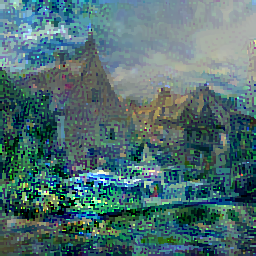

Train step: 5000
Total time: 178.1
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240331221516.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# EXPERIMENT 2.1

# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (gram matrix style and content)
gram_extractor = StyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = gram_extractor(style_image)['style']
content_targets = gram_extractor(content_image)['content']

# Based on visual inspection, use the best weights from Experiment 1.1
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 30, 500)

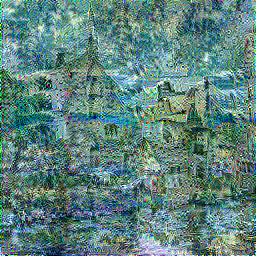

Train step: 10000
Total time: 770.4
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=50
Saving wasserstein-stylized-image-20240401060615.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# EXPERIMENT 2.2

# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (just get unmodified activation outputs/feature maps)
# no gram matrix!
wasserstein_extractor = WassersteinStyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = wasserstein_extractor(style_image)['style']
content_targets = wasserstein_extractor(content_image)['content']

list_activations_example = []
for item in style_targets.keys():
  # print(item)
  list_activations_example.append(style_targets[item])
for item in content_targets.keys():
  # print(item)
  list_activations_example.append(content_targets[item])


image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 50, 100)

1597558/1597558 [==============================] - 0s 0us/step


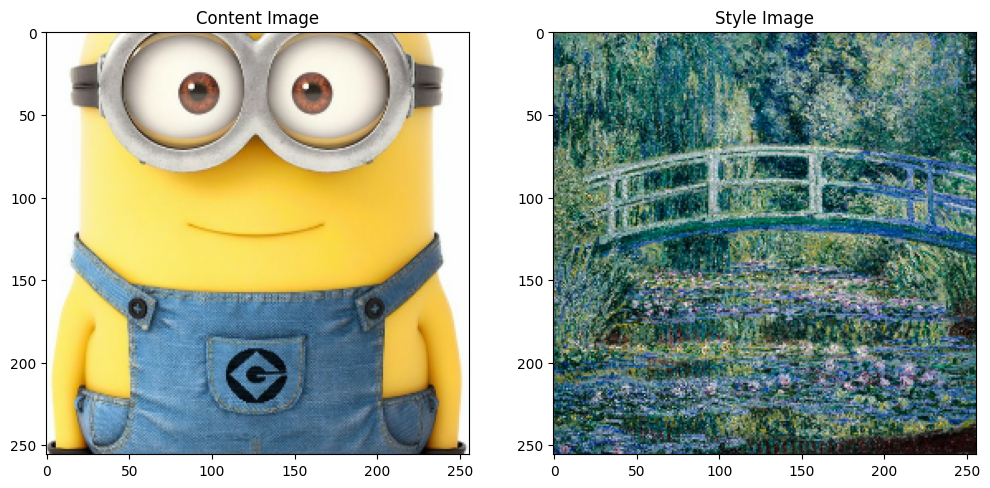

In [ ]:
content_path = tf.keras.utils.get_file('minon.jpg','https://i1.sndcdn.com/artworks-EtyDSA7Lz55JVNmo-zbagBw-t500x500.jpg')
style_path = tf.keras.utils.get_file('bridge_over_pond.jpg','https://www.kunstloft.com/wordpress/en_UK/eu/wp-content/uploads/2023/07/Bridge-over-a-pond-with-lilies-scaled-1-2000x1931.jpeg')

content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

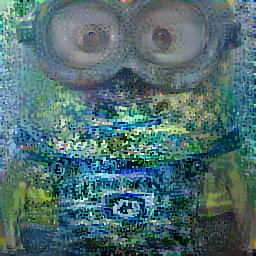

Train step: 5000
Total time: 179.7
Hyperparameters: style_weight=0.001, content_weight=1000.0, total_variation_weight=30
Saving gram-stylized-image-20240331213658.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# EXPERIMENT 2.1

# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (gram matrix style and content)
gram_extractor = StyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = gram_extractor(style_image)['style']
content_targets = gram_extractor(content_image)['content']

# Based on visual inspection, use the best weights from Experiment 1.1
image_var = tf.Variable(content_image)
train_gram(1e-3, 1e3, 30, 500)

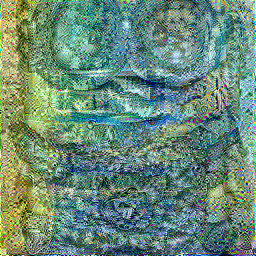

Train step: 10000
Total time: 770.7
Hyperparameters: style_weight=100000000.0, content_weight=100000000.0, total_variation_weight=50
Saving wasserstein-stylized-image-20240401055324.png


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# EXPERIMENT 2.2

# content = the final few layers represent higher-level features—object parts like wheels or eyes
content_layers = ['block5_conv2', 'block5_conv3', 'block5_conv4']

# style = the first few layer activations represent low-level features like edges and textures.
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv2',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

# Declare vgg model to obtain style/content layer outputs (just get unmodified activation outputs/feature maps)
# no gram matrix!
wasserstein_extractor = WassersteinStyleContentModel(style_layers, content_layers)

# Set your style and content target values (THESE ARE CONSTANTS!):
style_targets = wasserstein_extractor(style_image)['style']
content_targets = wasserstein_extractor(content_image)['content']

list_activations_example = []
for item in style_targets.keys():
  # print(item)
  list_activations_example.append(style_targets[item])
for item in content_targets.keys():
  # print(item)
  list_activations_example.append(content_targets[item])


image_var = tf.Variable(content_image)
train_wasserstein(1e8, 1e8, 50, 100)

### Metrics (comparing Gram vs SWD) and Summary of Visual Inspection (Belfry content image)

A new content/style image are used in these trials.

In [ ]:
content_path = tf.keras.utils.get_file('belfry.jpg','https://storage.googleapis.com/khanhlvg-public.appspot.com/arbitrary-style-transfer/belfry-2611573_1280.jpg')
style_path = tf.keras.utils.get_file('bridge_over_pond.jpg','https://www.kunstloft.com/wordpress/en_UK/eu/wp-content/uploads/2023/07/Bridge-over-a-pond-with-lilies-scaled-1-2000x1931.jpeg')


1597558/1597558 [==============================] - 1s 1us/step


{'content_ssim': 0.316577,
 'style_ssim': 0.10211124,
 'content_style_ratio': 3.1003146}

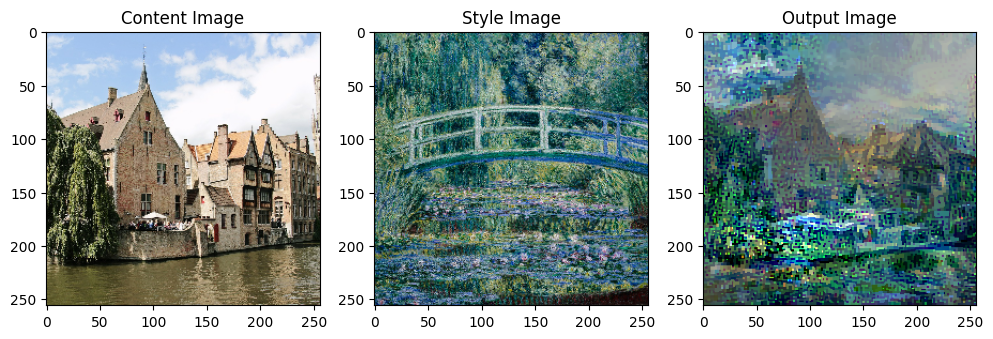

In [ ]:
output_path = 'gram-stylized-image-20240331221516.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

80134624/80134624 [==============================] - 3s 0us/step


{'content_loss_l2': 17071.336}

{'content_ssim': 0.10184628,
 'style_ssim': 0.062481094,
 'content_style_ratio': 1.6300335}

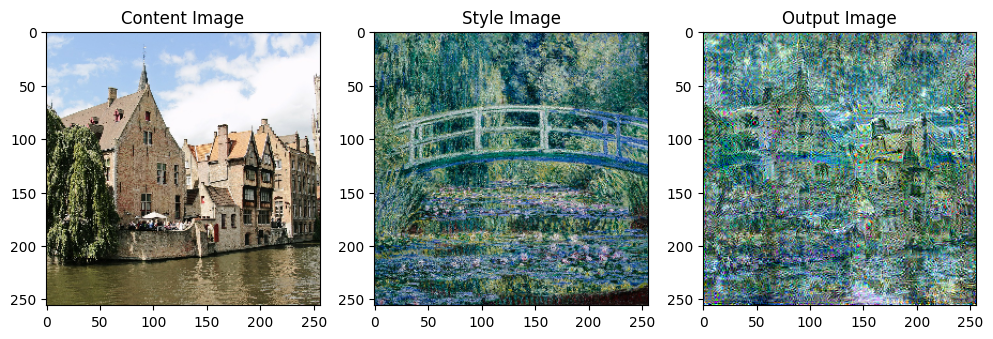

In [ ]:
output_path = 'wasserstein-stylized-image-20240401060615.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

{'content_loss_l2': 18739.367}

#### Description of Results

It appears that certain style images are harder to capture statistics for. The gram method does better at capturing monet and the fine paint details. Potentially the SWL captures too many features across many different directions. Maybe capturing information in the major directions of the distribution as done with the Gram matrix works better at removing noise/capturing main features.

Based on content loss and cotent style ratio, it looks like the SWL method is very style heavy.

### Metrics (comparing Gram vs SWD) and Summary of Visual Inspection (Minion content image)

A new content/style image are used in these trials.

In [ ]:
content_path = tf.keras.utils.get_file('minion.jpg','https://i1.sndcdn.com/artworks-EtyDSA7Lz55JVNmo-zbagBw-t500x500.jpg')
style_path = tf.keras.utils.get_file('bridge_over_pond.jpg','https://www.kunstloft.com/wordpress/en_UK/eu/wp-content/uploads/2023/07/Bridge-over-a-pond-with-lilies-scaled-1-2000x1931.jpeg')


   8192/Unknown - 0s 0us/step

{'content_ssim': 0.29171818,
 'style_ssim': 0.106791295,
 'content_style_ratio': 2.7316663}

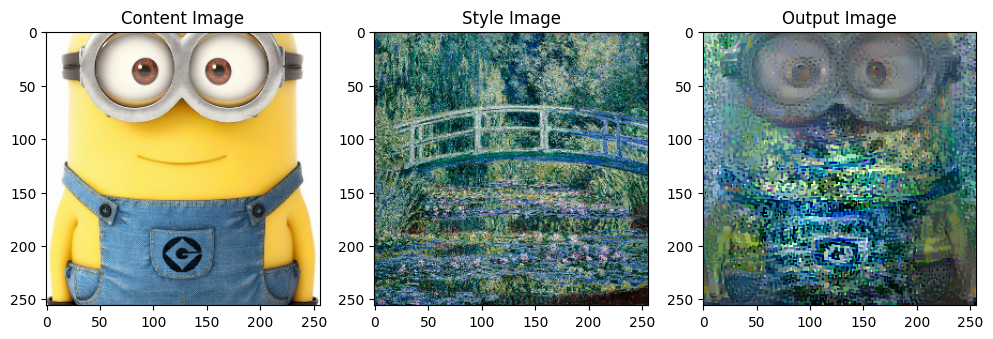

In [ ]:
output_path = 'gram-stylized-image-20240331213658.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

{'content_loss_l2': 25230.703}

{'content_ssim': 0.0966514,
 'style_ssim': 0.068114854,
 'content_style_ratio': 1.4189475}

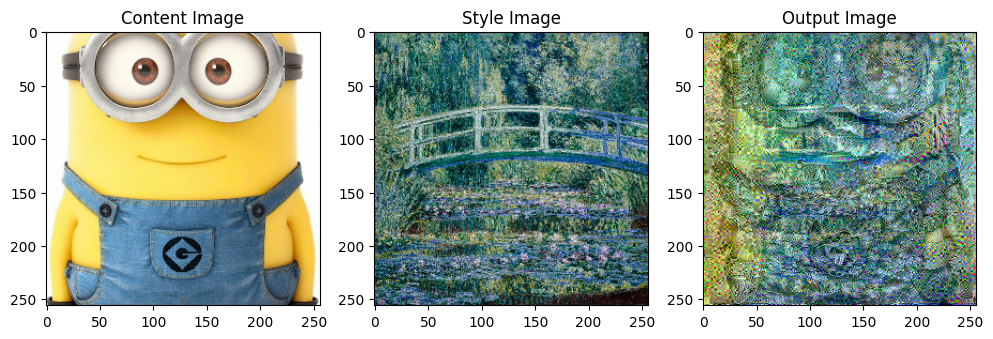

In [ ]:
output_path = 'wasserstein-stylized-image-20240401055324.png'
structural_sim(output_path, content_path, style_path)

In [ ]:
content_distance_li_et_al(output_path, content_path, style_path)

{'content_loss_l2': 28131.158}

#### Description of Results

With a more difficult content image (minion) adn style image (monet) both gram and SWL performed poorly. The content is still discernable but the style is not as refined and looks pixelated. This could mean that an optimal solution is not being reached. Using a better optimizer (LBFGS) or a larger learning rate could help.

An imporrtant observation is that Monet's style uses more muted colours. The gram result is a bit too bright in some parts but Wasserstein captures the texture of monet better. Potentially using a better optimizer would improve results.

## Overall Analysis of Results (comparing Gram/SWL)

Overall:
* Increasing style weight increased style and made content image less defined
* Increasing content weight made the content image more obvious but style was not as strong
* Regularization helped remove HF artifacts, but increasing the magnitude of the regularization term didn't always have obvious effects
* Adding more layers slightly improved results
* Training for more epochs improved the results, mostly for the wasserstein (made colours brighter, content image more defined)
* For more abstract style images, the results are not as clear (i.e. monet performed poorly on the minion image). Potentially this could just be because a minon painted in monet is not very visually appealing.


Overall, I would say that Wasserstein did a better job at capturing textures/style (while still making the image discernable, except with MinionxMonet). However, gram did a better job of capturing clearer content. Potentially using a different optimizer might improve results for both Gram and Wasserstein would improve the results. The papers recommended LBFGS but Adam worked fine and was used in the TF tutorial.


Trends in gram/wasserstein
* Wasserstein was usually more style heavy -- potentially need a better way to capture content statistics other than MSE (i.e. use MSE or better optimizer)
